Daren Ma
----

# 1. AdaBoost on a toy dataset

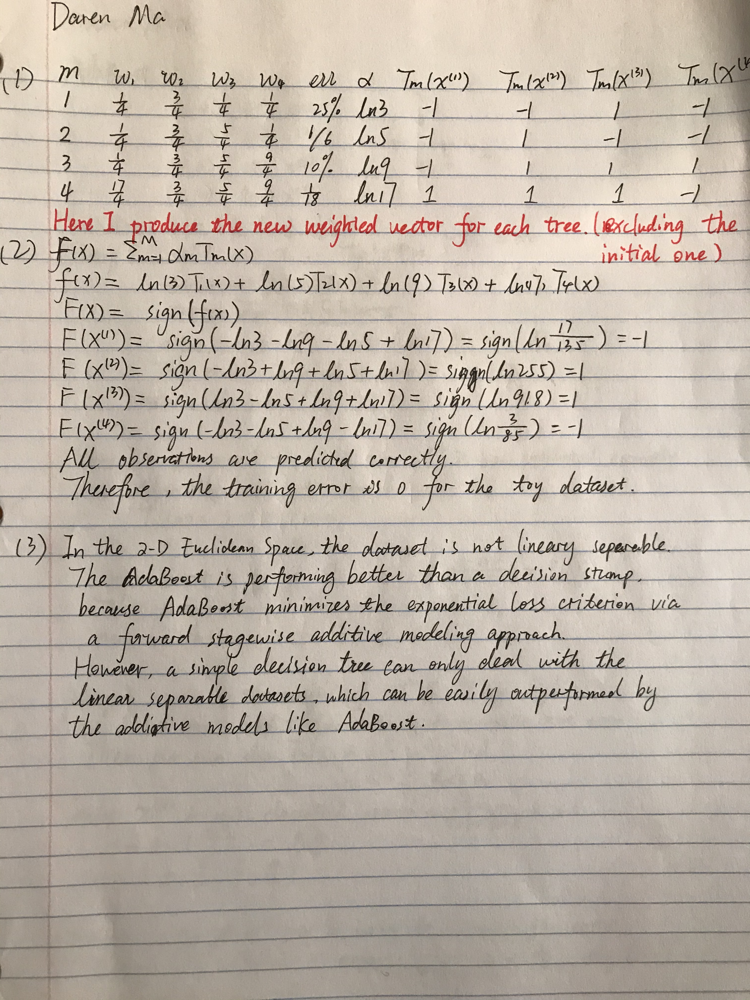

# 2. Implement AdaBoost

# Adaboost
For this exercise you will implement AdaBoost from scratch and applied it to a spam dataset. You will be classifying data into spam and not spam. You can call DecisionTreeClassifier from sklearn (with default max_depth=1) to learn your base classifiers.

Here is how you train a decision tree classifier with weights.

`
h = DecisionTreeClassifier(max_depth=max_depth, random_state=0)
h.fit(X, Y, sample_weight=w)
`

In [1]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier

In [2]:
# accuracy computation
# this data is not highly imbalance so accuracy is ok
def accuracy(y, pred):
    return np.sum(y == pred) / float(len(y)) 

In [3]:
def parse_spambase_data(filename):
    """ Given a filename return X and Y numpy arrays

    X is of size number of rows x num_features
    Y is an array of size the number of rows
    Y is the last element of each row. (Convert 0 to -1)
    """
    ### BEGIN SOLUTION
    data = np.loadtxt(filename, delimiter=',')
    X = data[:,:-1]
    Y = data[:,-1]
    Y = np.where(Y == 0, -1, Y)
    ### END SOLUTION
    return X, Y

In [4]:
y_test = np.array([1., -1., 1., 1., -1., -1., 1., 1., 1., -1.])
X, Y = parse_spambase_data("tiny.spam.train")
for i in range(len(y_test)): assert(y_test[i] == Y[i])
n, m = X.shape
assert(n == 10)
assert(m == 57)

In [5]:
def adaboost(X, y, num_iter, max_depth=1):
    """Given an numpy matrix X, a array y and num_iter return trees and weights 
   
    Input: X, y, num_iter
    Outputs: array of trees from DecisionTreeClassifier
             trees_weights array of floats
    Assumes y is {-1, 1}
    """
    trees = []
    trees_weights = [] 
    N, _ = X.shape
    d = np.ones(N) / N
    print("init_d:", d)
    ### BEGIN SOLUTION
    for i in range(num_iter):
        temp_tree = DecisionTreeClassifier(max_depth=max_depth, random_state=0)
        temp_tree.fit(X, y, sample_weight=d)
        y_pred = temp_tree.predict(X)
        error = np.sum(np.where(y_pred==y, 0, d))/np.sum(d)
        alpha = np.log((1-error)/error)
        d = d * np.exp(alpha*np.where(y_pred==y, 0, 1))
        print(d)
        trees.append(temp_tree)
        trees_weights.append(alpha)
    ### END SOLUTION
    return trees, trees_weights

In [6]:
X, Y = parse_spambase_data("tiny.spam.train")
trees, weights = adaboost(X, Y, 2)
y_hat_0 = trees[0].predict(X)
assert(len(trees) == 2)
assert(len(weights) == 2)
assert(isinstance(trees[0], DecisionTreeClassifier))
assert(np.array_equal(y_hat_0[:5], [1.,-1.,1, 1, -1]))

init_d: [0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
[0.1 0.1 0.1 0.1 0.1 0.1 0.9 0.1 0.1 0.1]
[0.1 0.1 0.1 0.1 0.1 1.7 0.9 0.1 0.1 0.1]


In [7]:
y_hat_0 = trees[0].predict(X)
assert(np.array_equal(y_hat_0[:5], [1.,-1.,1, 1, -1]))

In [8]:
def adaboost_predict(X, trees, trees_weights):
    """Given X, trees and weights predict Y
    """
    # X input, y output
    N, _ =  X.shape
    y = np.zeros(N)
    ### BEGIN SOLUTION
    for i in range(len(trees)):
        y += trees_weights[i] * trees[i].predict(X)
    y = np.where(y>0, 1, -1)
    
    ### END SOLUTION
    return y

In [9]:
x = np.array([[0, -1], [1, 0], [-1, 0]])
y = np.array([-1, 1, 1])
trees, weights = adaboost(x, y, 1)
pred = adaboost_predict(x, trees, weights)
assert(np.array_equal(pred, y))

init_d: [0.33333333 0.33333333 0.33333333]
[nan nan nan]


/Users/darenma/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:20: RuntimeWarning: divide by zero encountered in double_scalars
/Users/darenma/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in multiply


In [10]:
X, Y = parse_spambase_data("spambase.train")
X_test, Y_test = parse_spambase_data("spambase.test")
trees, trees_weights = adaboost(X, Y, 10)
Yhat = adaboost_predict(X, trees, trees_weights)
Yhat_test = adaboost_predict(X_test, trees, trees_weights)
    
acc_test = accuracy(Y_test, Yhat_test)
acc_train = accuracy(Y, Yhat)
print("Train Accuracy %.4f" % acc_train)
print("Test Accuracy %.4f" % acc_test)
assert(np.around(acc_train, decimals=4)==0.9111)
assert(np.around(acc_test, decimals=4)==0.9190)

init_d: [0.00027778 0.00027778 0.00027778 ... 0.00027778 0.00027778 0.00027778]
[0.00104848 0.00027778 0.00027778 ... 0.00027778 0.00027778 0.00027778]
[0.00328846 0.00027778 0.00027778 ... 0.00027778 0.00087122 0.00087122]
[0.00328846 0.00027778 0.00027778 ... 0.00070446 0.00087122 0.00220947]
[0.00328846 0.00027778 0.00068923 ... 0.00070446 0.00087122 0.00220947]
[0.00328846 0.00027778 0.00068923 ... 0.00070446 0.00167118 0.00423821]
[0.00328846 0.00057449 0.00068923 ... 0.00145692 0.00345626 0.00423821]
[0.00634733 0.00057449 0.00068923 ... 0.00145692 0.00345626 0.00423821]
[0.00634733 0.00085411 0.00068923 ... 0.00145692 0.00345626 0.00630112]
[0.00634733 0.00085411 0.00068923 ... 0.00145692 0.0059611  0.00630112]
[0.00634733 0.00085411 0.00068923 ... 0.00145692 0.00854995 0.00903764]
Train Accuracy 0.9111
Test Accuracy 0.9190


# 3. Implement Gradient Boosting for MSE

# Gradient boosting for regression with MSE loss
For this exercise you will implement a version of gradient boosting from scratch and applied it to predict rental prices. You can call DecisionTreeRegressor from sklearn to learn your base classifiers.
 
`tree = DecisionTreeRegressor(max_depth=max_depth, random_state=0)`

In [11]:
def load_dataset():
    dataset = np.loadtxt("rent-ideal.csv", delimiter=",", skiprows=1)
    y = dataset[:, -1]
    X = dataset[:, 0:- 1]
    return X, y

In [12]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split


def gradient_boosting_mse(X, y, num_iter, max_depth=1, nu=0.1):
    """Given X, a array y and num_iter return y_mean and trees 
   
    Input: X, y, num_iter
           max_depth
           nu (is the shinkage)
    Outputs:y_mean, array of trees from DecisionTreeRegression
    """
    trees = []
    N, _ = X.shape
    y_mean = np.mean(y)
    fm = y_mean
    ### BEGIN SOLUTION
    for i in range(num_iter):
        residual = y-fm
        this_tree = DecisionTreeRegressor(max_depth=max_depth, random_state=0)
        this_tree.fit(X, residual)
        y_pred = this_tree.predict(X)
        fm = nu*y_pred + fm
        trees.append(this_tree)
    ### END SOLUTION
    return y_mean, trees   

In [13]:
def gradient_boosting_predict(X, trees, y_mean,  nu=0.1):
    """Given X, trees, y_mean predict y_hat
    """
    ### BEGIN SOLUTION
    y_hat = y_mean
    for tree in trees:
        y_hat += nu*tree.predict(X)
    ### END SOLUTION
    return y_hat

In [14]:
X, y = load_dataset()
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.33, random_state=3)

y_mean, trees = gradient_boosting_mse(X_train, y_train, 300, max_depth=7, nu=0.1)
assert(np.around(y_mean, decimals=4)==3434.7185)
y_hat_train = gradient_boosting_predict(X_train, trees, y_mean, nu=0.1)
assert(np.around(r2_score(y_train, y_hat_train), decimals=4)== 0.8993) 

In [15]:
y_hat = gradient_boosting_predict(X_val, trees, y_mean, nu=0.1)
assert(np.around(r2_score(y_val, y_hat), decimals=4)== 0.8399)

Find the best num_trees
----

In [51]:
X, y = load_dataset()
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.33, random_state=3)

groo = []
for num_trees in range(100, 4000, 100):
    y_mean, trees = gradient_boosting_mse(
        X_train, y_train, num_trees, max_depth=7, nu=0.1)
    y_hat_train = gradient_boosting_predict(X_train, trees, y_mean, nu=0.1)
    y_hat_val = gradient_boosting_predict(X_val, trees, y_mean, nu=0.1)
    r2_t = r2_score(y_train, y_hat_train)
    r2_v = r2_score(y_val, y_hat_val)
    groo.append([num_trees, r2_t, r2_v])
    print(f"{num_trees} trees this time", ":", f"training score {r2_t:.4f}")
    print(f"{num_trees} trees this time", ":", f"validation score {r2_v:.4f}\n")

100 trees this time : training score 0.8401
100 trees this time : validation score 0.8000

200 trees this time : training score 0.8788
200 trees this time : validation score 0.8270

300 trees this time : training score 0.8993
300 trees this time : validation score 0.8399

400 trees this time : training score 0.9112
400 trees this time : validation score 0.8463

500 trees this time : training score 0.9210
500 trees this time : validation score 0.8511

600 trees this time : training score 0.9288
600 trees this time : validation score 0.8547

700 trees this time : training score 0.9340
700 trees this time : validation score 0.8572

800 trees this time : training score 0.9384
800 trees this time : validation score 0.8586

900 trees this time : training score 0.9414
900 trees this time : validation score 0.8596

1000 trees this time : training score 0.9438
1000 trees this time : validation score 0.8602

1100 trees this time : training score 0.9459
1100 trees this time : validation score 0.8

In [52]:
print(groo)

[[100, 0.8401367304521943, 0.7999981695449199], [200, 0.878787435525412, 0.827030746089199], [300, 0.8992624536968568, 0.83991092153146], [400, 0.9111661395992628, 0.8462572594858122], [500, 0.9210498610749862, 0.8511052020463824], [600, 0.9287918492197651, 0.8547358211375724], [700, 0.9339899236085084, 0.8572124994221836], [800, 0.9384132222323673, 0.8585822650871681], [900, 0.9414111471421603, 0.8596370544534391], [1000, 0.9438098670990429, 0.8601586056701734], [1100, 0.9458733266329702, 0.8605753352110884], [1200, 0.9478287614542661, 0.8609367868247537], [1300, 0.949143616177322, 0.8612358007234321], [1400, 0.9503589343425184, 0.8613714277169207], [1500, 0.9515877415075272, 0.8615352699937915], [1600, 0.9525935621190842, 0.8615771605538965], [1700, 0.9534086422041435, 0.8616905282981852], [1800, 0.954019426485742, 0.8617472610574276], [1900, 0.9545781981126513, 0.8617310005546408], [2000, 0.955161436701935, 0.8617908855449338], [2100, 0.9555220908580885, 0.8616943145490108], [2200, 

In [16]:
import pandas as pd
import matplotlib.pyplot as plt

In [55]:
pd.DataFrame(groo).to_csv("ploting")

### Plot showing the training and validating $R^2$

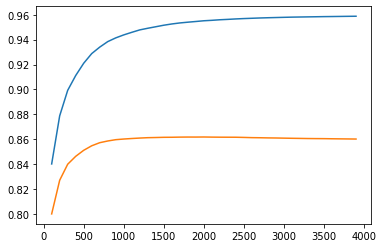

In [37]:
product = pd.read_csv("ploting")
product.columns = ["index", "trees", "r2_train", "r2_valid"]
plt.plot(product.trees, product[["r2_train", "r2_valid"]])
plt.show()

### Find the best number of trees

In [38]:
product.loc[product.r2_valid.max()==product.r2_valid]

,index,trees,r2_train,r2_valid
19,19,2000,0.955161,0.861791


### Compare with the XGBoost package

In [24]:
from xgboost import XGBRegressor


In [26]:
XGBRegressor?

In [31]:
model0 = xgb.XGBRegressor(learning_rate=0.1,
                          objective='reg:squarederror',
                          n_estimators=2000,
                          max_depth=7,
#                           subsample=1,
#                           colsample_bytree=1,
                          n_jobs=10,
                          scale_pos_weight=1)
model0.fit(X_train, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=7, min_child_weight=1, missing=None, n_estimators=2000,
             n_jobs=10, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1)

In [32]:
print(model0.score(X_train,y_train))
print(model0.score(X_val,y_val))

0.9512252728497952
0.8627778191697739


In [33]:
phoo = []
for num_trees in range(100, 4000, 100):
    model_x = xgb.XGBRegressor(learning_rate=0.1,
                          objective='reg:squarederror',
                          n_estimators=num_trees,
                          max_depth=7,
                          n_jobs=10,
                          scale_pos_weight=1)
    model_x.fit(X_train, y_train)
    r2_xt = model_x.score(X_train,y_train)
    r2_xv = model_x.score(X_val,y_val)
    phoo.append([num_trees, r2_xt, r2_xv])

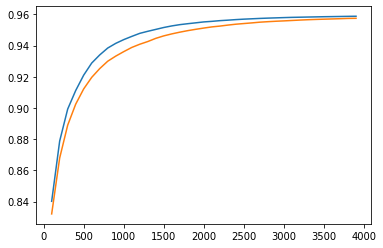

In [45]:
dfxgb = pd.DataFrame(phoo)

dfxgb.columns = ["trees", "r2_train", "r2_valid"]
dfnew = pd.merge(product, dfxgb, on="trees", how='inner')
dfnew
plt.plot(dfnew.trees, dfnew[['r2_train_x', 'r2_train_y']], label=True)
plt.show()

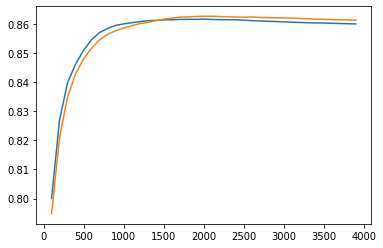

In [46]:
plt.plot(dfnew.trees, dfnew[['r2_valid_x', 'r2_valid_y']], label=True)
plt.show()

According to the results above, my Gradient Boosting has a higher training $R^2$ and validation $R^2$ before 1500 trees.

However, my GB model produced lower validation $R^2$ with almost the same hyper parameters with more trees added (roughly > 1500).

Therefore, my algorithm is overfitting a little bit.